# Explain clusters to business with Altair and Shapley values
> Everyone that calls herselve a data scientist has at least clustered the Iris dataset. This notebook goes beyond the classical dimension reduction and clustering. I gives you two extra superpowerS to explain the resulting clusters to your client. 
- First: I'll show how we can add extra insight by using interactive charts made with interactive graphs in Altair.
- Second I explain and show how to derive important clues from Shap values by training a classification model on the clustering result. With the Altair and shap libraries in your datascience toolbelt, you will excel at the clustering tasks thrown at you.

- toc:true
- branch: master
- badges: true
- comments: true
- author: Lode Nachtergaele
- image: pca_cluster_altair_view.png
- categories: [datascience, python, clustering, altair, shap]

The data is a set of about 5000 wines from the UCI Machine learning Repository. The dataset is related to the white variants of the Portuguese "Vinho Verde" wine. There are 11 features that describe chemical characteristics of the wines. The task is to find clusters of wine that are in a way similar to each other. By reducing the 5000 wines to a small number of groups of wine, you can give strategic advise to your business by generalising per cluster instead of per wine.

We are not using the quality of the wine. This notebook is to illustrate a unsupervised clustering approach. We start from the classic PCA dimension reduction for visualisation and Kmeans for clustering. Other dimension reduction techniques (LDA, [UMAP](https://umap-learn.readthedocs.io/en/latest/), t-sne, [ivis](https://github.com/beringresearch/ivis), ...) and clustering techniques (density based, aglomerative, gaussian mixture, ...) are left as an excercise for the reader.

### **References**

Dua, D. and Karra Taniskidou, E. (2017). UCI Machine Learning Repository [http://archive.ics.uci.edu/ml]. Irvine, CA: University of California, School of Information and Computer Science.

In [0]:
# Load python libraries for data handling and plotting
import numpy as np
import pandas as pd
import altair as alt
import matplotlib.pyplot as plt

In [0]:
# Load the data set with wines from the internet
df = pd.read_csv('https://archive.ics.uci.edu/ml/machine-learning-databases/wine-quality/winequality-white.csv', sep=';')

In [3]:
# Show the first lines of the data set to get an idea what's in there.
df.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6
1,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6
2,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6
3,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6
4,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6


In [4]:
# How many wines and features do we have ?
df.shape

(4898, 12)

In [5]:
df.columns

Index(['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar',
       'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density',
       'pH', 'sulphates', 'alcohol', 'quality'],
      dtype='object')

In [0]:
# Define the standard X (feature matrix) and target series y (not used in here)
X =  df.drop(columns='quality')
all_features = X.columns
y = df['quality']

In [7]:
df.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000
mean,6.854788,0.278241,0.334192,6.391415,0.045772,35.308085,138.360657,0.994027,3.188267,0.489847,10.514267,5.877909
std,0.843868,0.100795,0.121020,5.072058,0.021848,17.007137,42.498065,0.002991,0.151001,0.114126,1.230621,0.885639
min,3.800000,0.080000,0.000000,0.600000,0.009000,2.000000,9.000000,0.987110,2.720000,0.220000,8.000000,3.000000
25%,6.300000,0.210000,0.270000,1.700000,0.036000,23.000000,108.000000,0.991723,3.090000,0.410000,9.500000,5.000000
50%,6.800000,0.260000,0.320000,5.200000,0.043000,34.000000,134.000000,0.993740,3.180000,0.470000,10.400000,6.000000
75%,7.300000,0.320000,0.390000,9.900000,0.050000,46.000000,167.000000,0.996100,3.280000,0.550000,11.400000,6.000000
max,14.200000,1.100000,1.660000,65.800000,0.346000,289.000000,440.000000,1.038980,3.820000,1.080000,14.200000,9.000000


In [8]:
alt.Chart(df).mark_point().encode(x='fixed acidity', y='volatile acidity', color='quality:N')

alt.Chart(...)

In [9]:
# Add interactivity
alt.Chart(df).mark_point().encode(x='fixed acidity', y='volatile acidity', color='quality:N', tooltip=['alcohol', 'quality']).interactive()

alt.Chart(...)

# Scaling

From the describe, we see that domains of the feature differ widely. Feature 'fixed acidity' has mean 6.854788, while feature 'volatile acidity' has mean 0.278241. This is a sign that are on a different scale. We scale the features first so that we can use them together.

In [0]:
# When features have different scale we have to scale them so that we can use them together
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import StandardScaler

In [0]:
scaler = StandardScaler() 
# scaler = RobustScaler()  # Take the robust scaler when data contains outliers that you want to remove

In [0]:
X_scaled = scaler.fit_transform(X)

# PCA

Perform principal component analysis to get an idea of the dimensionality of the wine dataset. Next reduce to two dimension so that we can make a 2D scatter plot were each dot is a wine from the set.

In [0]:
from sklearn.decomposition import PCA
pca = PCA().fit(X_scaled)

In [14]:
df_plot = pd.DataFrame({'Component Number': 1+np.arange(X.shape[1]),
                        'Cumulative explained variance': np.cumsum(pca.explained_variance_ratio_)})
alt.Chart(df_plot).mark_bar().encode(
    x=alt.X('Component Number:N', axis=alt.Axis(labelAngle=0)),
    y=alt.Y('Cumulative explained variance', axis=alt.Axis(format='%', title='Percentage')),
    tooltip=[alt.Tooltip('Cumulative explained variance', format='.0%')]
).properties(
    title='Cumulative explained variance'
).properties(
    width=400
)

alt.Chart(...)

We see that almost all features are needed to explain all the variance. Only with 9 comoponent we can explain 97% of the variance. This means that we should use all features from the dataset and feature selection is not necessary in this case.

# PCA with 2 Dimensions

Perform dimension reduction to two dimentions with PCA to be able to draw all the wines in one graph (not for the clustering!)

In [0]:
twod_pca = PCA(n_components=2)
X_pca = twod_pca.fit_transform(X_scaled)

In [0]:
# Add first to PCA components to the dataset so we can plot it
df['pca1'] = X_pca[:,0]
df['pca2'] = X_pca[:,1]

In [17]:
df['member'] = 1
df.groupby('quality')['member'].transform('count').div(df.shape[0])

0       0.448755
1       0.448755
2       0.448755
3       0.448755
4       0.448755
          ...   
4893    0.448755
4894    0.297468
4895    0.448755
4896    0.179665
4897    0.448755
Name: member, Length: 4898, dtype: float64

In [18]:
selection = alt.selection_multi(fields=['quality'], bind='legend')

df['quality_weight'] = df['quality'].map(df['quality'].value_counts(normalize=True).to_dict())
# Draw 20% stratified sample
alt.Chart(df.sample(1000, weights='quality_weight')).mark_circle(size=60).encode(
    x=alt.X('pca1', title='First component'),
    y=alt.Y('pca2', title='Second component'),
    color=alt.Color('quality:N'),
    tooltip=['quality'],
    opacity=alt.condition(selection, alt.value(1), alt.value(0.2))
).properties(
    title='PCA analyse',
    width=600,
    height=400
).add_selection(
    selection
)

alt.Chart(...)

In [0]:
df_twod_pca = pd.DataFrame(data=twod_pca.components_.T, columns=['pca1', 'pca2'], index=X.columns)

In [20]:
pca1 = alt.Chart(df_twod_pca.reset_index()).mark_bar().encode(
    y=alt.Y('index:O', title=None),
    x='pca1',
    color=alt.Color('pca1', scale=alt.Scale(scheme='viridis')),
    tooltip = [alt.Tooltip('index', title='Feature'), alt.Tooltip('pca1', format='.2f')]
)
pca2 = alt.Chart(df_twod_pca.reset_index()).mark_bar().encode(
    y=alt.Y('index:O', title=None),
    x='pca2',
    color=alt.Color('pca2', scale=alt.Scale(scheme='viridis')),
    tooltip = [alt.Tooltip('index', title='Feature'), alt.Tooltip('pca2', format='.2f')]
)

(pca1 & pca2).properties(
    title='Loadings of the first two principal components'
)

alt.VConcatChart(...)

# Kmeans clustering

Determine the number of cluster for Kmeans clustering by lopping from 2 to 11 cluster. Calculate for each result the within-cluster variation (inertia), the [silhoutte](https://en.wikipedia.org/wiki/Silhouette_(clustering)) and the [Davies-Bouldin index](n.wikipedia.org/wiki/Davies–Bouldin_index). Use the elbow method to determine the number of clusters. The elbow method seeks the value of k after which the clustering quality improves only marginally.

In [0]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score

In [22]:
km_scores= []
km_silhouette = []
km_db_score = []
for i in range(2,X.shape[1]):
    km = KMeans(n_clusters=i, random_state=1301).fit(X_scaled)
    preds = km.predict(X_scaled)
    
    print(f'Score for number of cluster(s) {i}: {km.score(X_scaled):.3f}')
    km_scores.append(-km.score(X_scaled))
    
    silhouette = silhouette_score(X_scaled,preds)
    km_silhouette.append(silhouette)
    print(f'Silhouette score for number of cluster(s) {i}: {silhouette:.3f}')
    
    db = davies_bouldin_score(X_scaled,preds)
    km_db_score.append(db)
    print(f'Davies Bouldin score for number of cluster(s) {i}: {db:.3f}')
    
    print('-'*100)

Score for number of cluster(s) 2: -42548.672
Silhouette score for number of cluster(s) 2: 0.214
Davies Bouldin score for number of cluster(s) 2: 1.775
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 3: -39063.495
Silhouette score for number of cluster(s) 3: 0.144
Davies Bouldin score for number of cluster(s) 3: 2.097
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 4: -35986.918
Silhouette score for number of cluster(s) 4: 0.159
Davies Bouldin score for number of cluster(s) 4: 1.809
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 5: -33699.043
Silhouette score for number of cluster(s) 5: 0.144
Davies Bouldin score for number of cluster(s) 5: 1.768
---------------------------------------------------------------------------------------------

In [23]:
df_plot = pd.DataFrame({'Number of clusters':[i for i in range(2,X.shape[1])],'kmean score': km_scores})
alt.Chart(df_plot).mark_line(point=True).encode(
    x=alt.X('Number of clusters:N', axis=alt.Axis(labelAngle=0)),
    y=alt.Y('kmean score'),
    tooltip=[alt.Tooltip('kmean score', format='.2f')]
).properties(
    title='Kmean score ifo number of cluster'
).properties(
    title='The elbow method for determining number of clusters',
    width=400
)

alt.Chart(...)

In [24]:
df_plot = pd.DataFrame({'Number of clusters':[i for i in range(2,X.shape[1])],'silhouette score': km_silhouette})
alt.Chart(df_plot).mark_line(point=True).encode(
    x=alt.X('Number of clusters:N', axis=alt.Axis(labelAngle=0)),
    y=alt.Y('silhouette score'),
    tooltip=[alt.Tooltip('silhouette score', format='.2f')]
).properties(
    title='Silhouette  score ifo number of cluster',
    width=400
)

alt.Chart(...)

In [25]:
df_plot = pd.DataFrame({'Number of clusters':[i for i in range(2, X.shape[1])],'davies bouldin score': km_db_score})
alt.Chart(df_plot).mark_line(point=True).encode(
    x=alt.X('Number of clusters:N', axis=alt.Axis(labelAngle=0)),
    y=alt.Y('davies bouldin score'),
    tooltip=[alt.Tooltip('davies bouldin score', format='.2f')]
).properties(
    title='Davies Bouldin score ifo number of cluster',
    width=400
)

alt.Chart(...)

For n_clusters = 2 The average silhouette_score is : 0.5062782327345698
For n_clusters = 3 The average silhouette_score is : 0.4125412743885912
For n_clusters = 4 The average silhouette_score is : 0.3748324919186734
For n_clusters = 5 The average silhouette_score is : 0.3437053439455249
For n_clusters = 6 The average silhouette_score is : 0.313821767576001


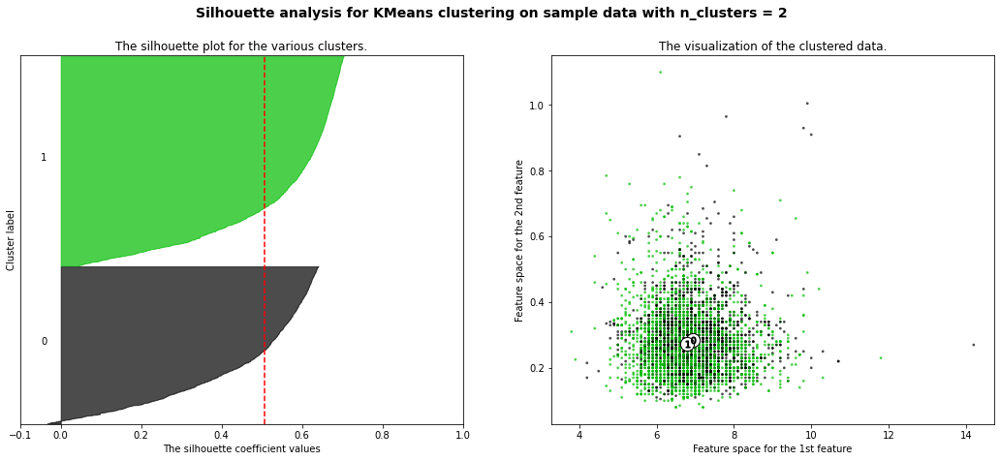

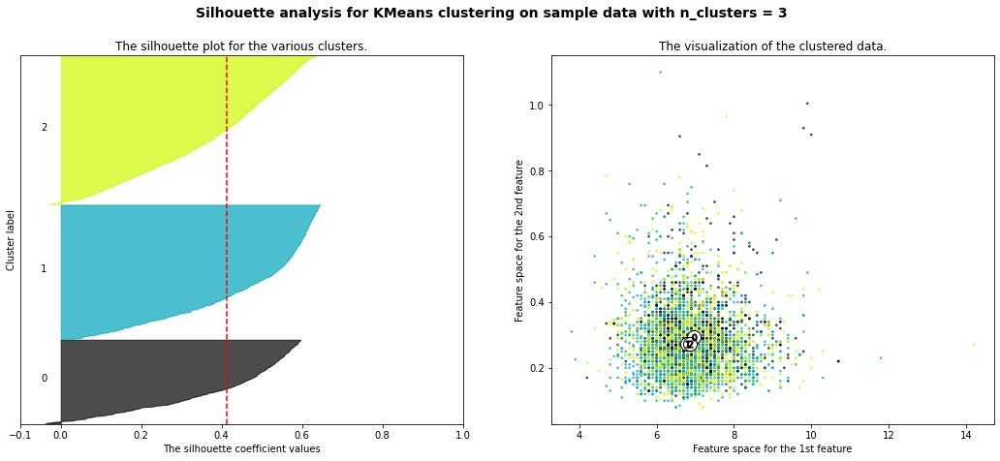

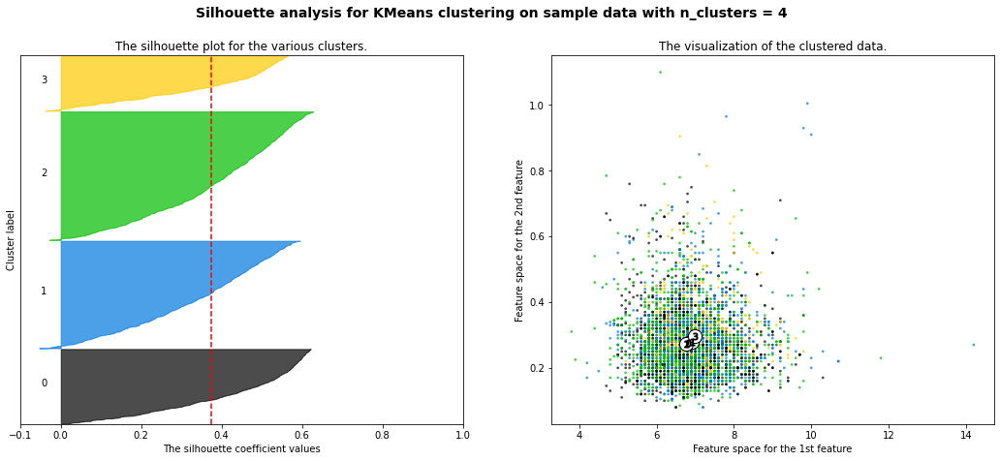

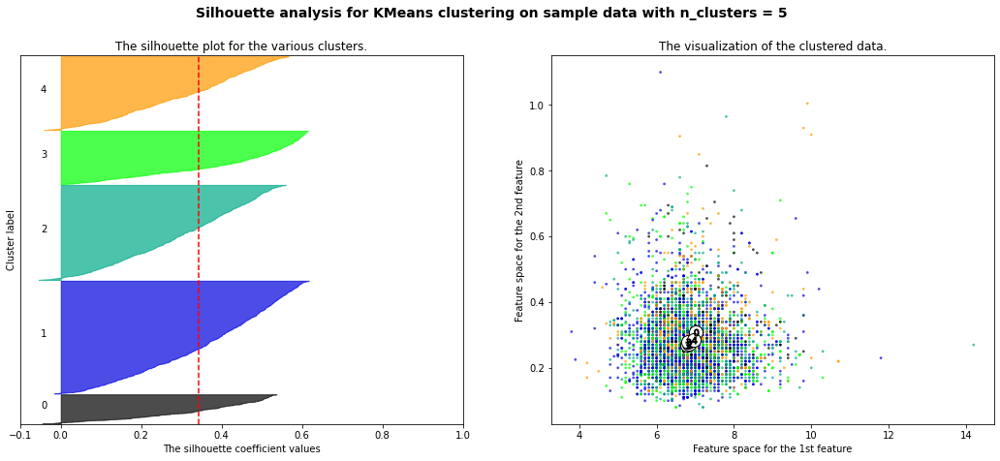

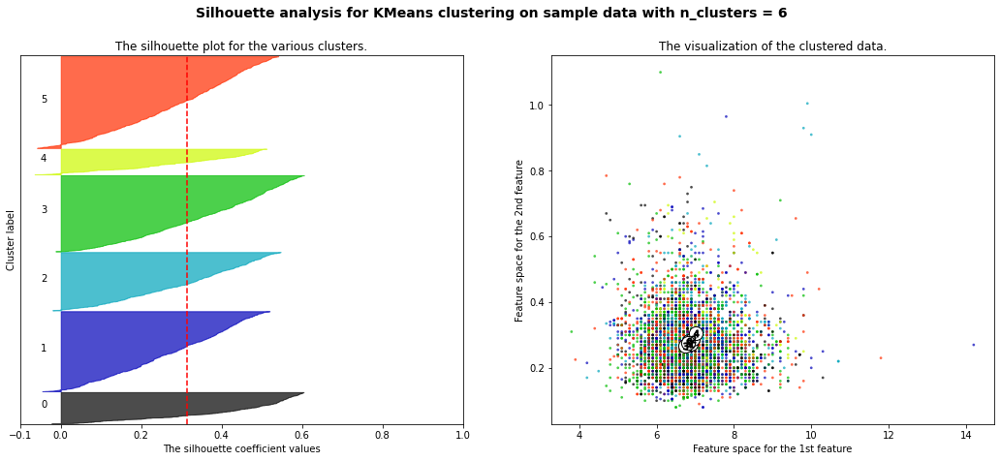

In [26]:
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm

X = X.values
range_n_clusters = [2, 3, 4, 5, 6]
for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

# Make three clusters

Since we have a high Davies Boldin and low Silhoutte score for k=3 we select to cluster into three clusters. Another option could be to use the [Gaussian Likelihood score](https://github.com/kerighan/gls). In this [notebook](https://www.kaggle.com/xvivancos/tutorial-clustering-wines-with-k-means) another analysis reported also 3 clusters.

In [27]:
km = KMeans(n_clusters=3, random_state=1301).fit(X_scaled)
preds = km.predict(X_scaled)
pd.Series(preds).value_counts() # How many wines are in each cluster ?

0    1801
1    1629
2    1468
dtype: int64

In [0]:
df_km = pd.DataFrame(data={'pca1':X_pca[:,0], 'pca2':X_pca [:,1], 'cluster':preds})

In [0]:
# Add the scaled data with the input features

for i,c in enumerate(all_features):
    df_km[c] = X_scaled[:,i]

In [30]:
domain = [0, 1, 2]
range_ = ['red',  'darkblue', 'green']

selection = alt.selection_multi(fields=['cluster'], bind='legend')

pca = alt.Chart(df_km).mark_circle(size=20).encode(
    x='pca1',
    y='pca2',
    color=alt.Color('cluster:N', scale=alt.Scale(domain=domain, range=range_)),
    opacity=alt.condition(selection, alt.value(1), alt.value(0.1)),
    tooltip = list(all_features)
).add_selection(
    selection
)

pca

alt.Chart(...)

Now we will plot the all the wines on a two dimensional plane. On the right, you get boxplots for every feature. The cool thing is now that with the mouse you can select by drawing a brush over the points (click, hold button and drag the mouse) and get immediate updates boxplots of the features of the selected wines. A such you can interactively gain some insight in what the cluster might mean.

In [31]:
brush = alt.selection(type='interval')

domain = [0, 1, 2]
range_ = ['red', 'darkblue', 'green']

points = alt.Chart(df_km).mark_circle(size=60).encode(
    x='pca1',
    y='pca2',
    color = alt.condition(brush, 'cluster:N', alt.value('lightgray')),
    tooltip = list(all_features)
).add_selection(brush)

boxplots = alt.vconcat()
for measure in all_features:
    boxplot = alt.Chart(df_km).mark_boxplot().encode(
            x =alt.X(measure, axis=alt.Axis(titleX=470, titleY=0)),
    ).transform_filter(
            brush
    )
    boxplots &= boxplot

chart = alt.hconcat(points, boxplots)
# chart.save('cluster_pca_n_3.html'))
chart

alt.HConcatChart(...)

AS you can't select al wine from one cluster with the rectangular brush, we make a plot for each cluster and boxplots of the features values of that cluster.

In [0]:
def plot_cluster(df, selected_columns, clusternr):
    points = alt.Chart(df).mark_circle(size=60).encode(
    x=alt.X('pca1', title='Principal component 1 (pca1)'),
    y=alt.Y('pca2', title='Principal component 2 (pca1)'),
    color = alt.condition(alt.FieldEqualPredicate(field='cluster', equal=clusternr), 'cluster:N', alt.value('lightgray')),
    tooltip = list(all_features)+['cluster'],
)

    boxplots = alt.vconcat()
    for measure in  [c for c in selected_columns]:
        boxplot = alt.Chart(df).mark_boxplot().encode(
                x =alt.X(measure, axis=alt.Axis(titleX=480, titleY=0)),
        ).transform_filter(
                alt.FieldEqualPredicate(field='cluster', equal=clusternr)
        )
        boxplots &= boxplot
    return points, boxplots

In [0]:
points, boxplots = plot_cluster(df_km, all_features, 0)
c0 = alt.hconcat(points, boxplots).properties(title='Cluster 0')
points, boxplots = plot_cluster(df_km, all_features, 1)
c1 = alt.hconcat(points, boxplots).properties(title='Cluster 1')
points, boxplots = plot_cluster(df_km, all_features, 2)
c2 = alt.hconcat(points, boxplots).properties(title='Cluster 2')

In [34]:
alt.vconcat(c0, c1, c2)

alt.VConcatChart(...)

I might still be difficult to explain the clusters. We will now build a multiclass classifier to predict the cluster from the features. Next we will use the Shapley values to explain the clusters.

# Light gbm classifier

In [0]:
import lightgbm as lgb

In [36]:
params = lgb.LGBMClassifier().get_params()
params

{'boosting_type': 'gbdt',
 'class_weight': None,
 'colsample_bytree': 1.0,
 'importance_type': 'split',
 'learning_rate': 0.1,
 'max_depth': -1,
 'min_child_samples': 20,
 'min_child_weight': 0.001,
 'min_split_gain': 0.0,
 'n_estimators': 100,
 'n_jobs': -1,
 'num_leaves': 31,
 'objective': None,
 'random_state': None,
 'reg_alpha': 0.0,
 'reg_lambda': 0.0,
 'silent': True,
 'subsample': 1.0,
 'subsample_for_bin': 200000,
 'subsample_freq': 0}

In [0]:
params['objective'] = 'multiclass' # the target to predict is the number of the cluster
params['is_unbalance'] = True
params['n_jobs'] = -1
params['random_state'] = 1301

In [0]:
mdl = lgb.LGBMClassifier(**params)

In [0]:
X =  df.drop(columns=['quality', 'pca1', 'pca2', 'member'])

In [40]:
mdl.fit(X, preds)

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', is_unbalance=True, learning_rate=0.1,
               max_depth=-1, min_child_samples=20, min_child_weight=0.001,
               min_split_gain=0.0, n_estimators=100, n_jobs=-1, num_leaves=31,
               objective='multiclass', random_state=1301, reg_alpha=0.0,
               reg_lambda=0.0, silent=True, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)

In [0]:
y_pred = mdl.predict_proba(X)

In [42]:
# Install the shap library to caculate the Shapley values
!pip install shap

In [0]:
import shap

In [44]:
explainer = shap.TreeExplainer(mdl)
shap_values = explainer.shap_values(X)

Setting feature_perturbation = "tree_path_dependent" because no background data was given.


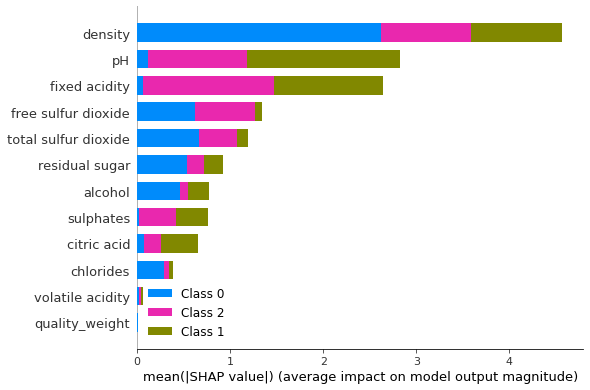

In [45]:
shap.summary_plot(shap_values, X, max_display=30)

From the Shapley values we see that the feature density has the highest impact on the model to predict the clusters. Let's have a look the Shapley values per cluster. The acidity features pH and fixed acidity has only impact on cluster 1 and 2 but almost none on cluster 0.

# Shapley values for the three clusters

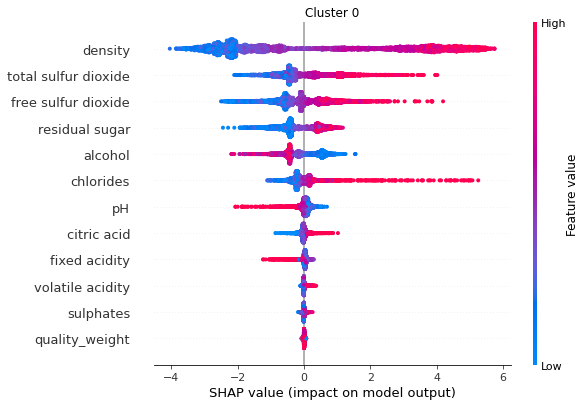

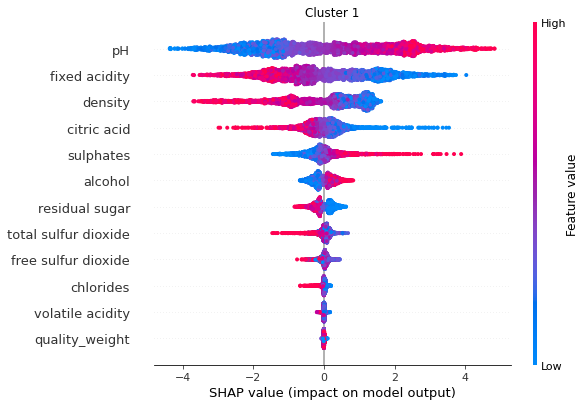

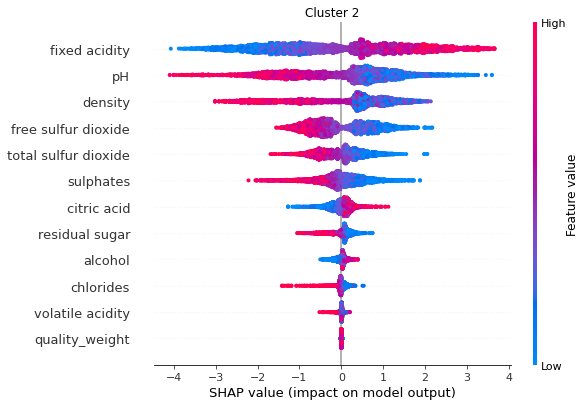

In [46]:
for cnr in df_km['cluster'].unique():
    shap.summary_plot(shap_values[cnr], X, max_display=30, show=False)
    plt.title(f'Cluster {cnr}')
    plt.show()

To explain the clusters, we will plot the three clusters and the boxplot of the features ordered with the feature importance.

# Explain cluster 0

In [47]:
cnr = 0
feature_order = np.argsort(np.sum(np.abs(shap_values[cnr]), axis=0))
points, boxplots = plot_cluster(df_km, [X.columns[i] for i in feature_order][::-1][:6], 0)
c0 = alt.hconcat(points, boxplots).properties(title='Cluster 0')
c0

alt.HConcatChart(...)

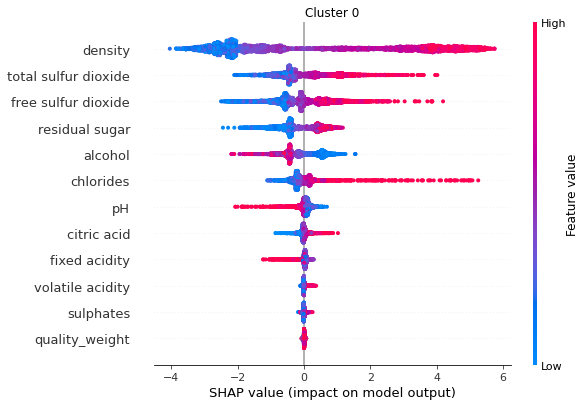

In [48]:
cnr = 0
shap.summary_plot(shap_values[cnr], X, max_display=30, show=False)
plt.title(f'Cluster {cnr}')
plt.show()

Cluster 0 can be describe as wines with:
- high density
- high total sulfur dioxide
- high free sulfur dioxide

# Explain cluster 1

In [49]:
X.columns

Index(['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar',
       'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density',
       'pH', 'sulphates', 'alcohol', 'quality_weight'],
      dtype='object')

In [50]:
cnr = 1
feature_order = np.argsort(np.sum(np.abs(shap_values[cnr]), axis=0))
points, boxplots = plot_cluster(df_km, [X.columns[i] for i in feature_order][::-1][:6], cnr)
c1 = alt.hconcat(points, boxplots).properties(title=f'Cluster {cnr}')
c1

alt.HConcatChart(...)

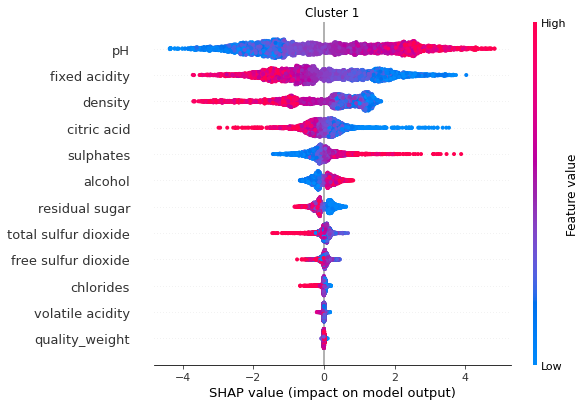

In [51]:
cnr = 1
shap.summary_plot(shap_values[cnr], X, max_display=30, show=False)
plt.title(f'Cluster {cnr}')
plt.show()

Cluster 1 contains wines with:
- high pH
- low fixed acidity
- low density (opposite of cluster 0)
- low citric acid
- high on sulphates

# Explain cluster 2

In [52]:
cnr = 2
feature_order = np.argsort(np.sum(np.abs(shap_values[cnr]), axis=0))
points, boxplots = plot_cluster(df_km, [X.columns[i] for i in feature_order][::-1][:6], cnr)
c2 = alt.hconcat(points, boxplots).properties(title=f'Cluster {cnr}')
c2

alt.HConcatChart(...)

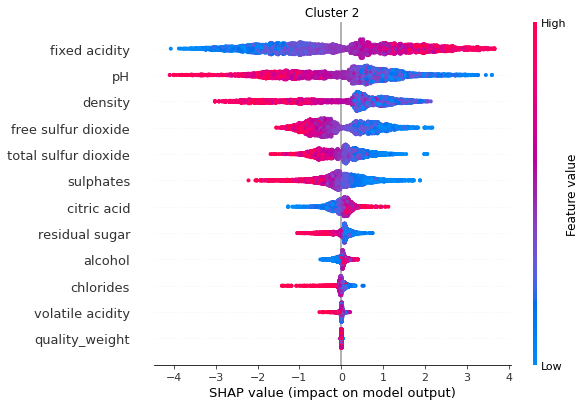

In [53]:
cnr = 2
shap.summary_plot(shap_values[cnr], X, max_display=30, show=False)
plt.title(f'Cluster {cnr}')
plt.show()

Cluster 2 contains wines with:
- high fixed acidity
- low pH (opposite of cluster 1)
- low density (opposite of cluster 0)


# How is the quality of the whines in each cluster ?

In [54]:
df_km['quality'] = y
df_km.groupby('cluster')['quality'].describe()

,count,mean,std,min,25%,50%,75%,max
cluster,,,,,,,,
0,1801.0,5.606330,0.750514,3.0,5.0,6.0,6.0,8.0
1,1629.0,6.150399,0.905265,3.0,6.0,6.0,7.0,9.0
2,1468.0,5.908719,0.918554,3.0,5.0,6.0,6.0,9.0


In [55]:
# Let's plot the distributions of quality score per cluster
alt.Chart(df_km).transform_density(
    density='quality',
    bandwidth=0.3,
    groupby=['cluster'],
    extent= [3, 9],
    counts = True,
    steps=200
).mark_area().encode(
    alt.X('value:Q'),
    alt.Y('density:Q', stack='zero'),
    alt.Color('cluster:N')
).properties(
    title='Distribution of quality of the wines per cluster',
    width=400,
    height=100
)

alt.Chart(...)

We see that the quality has a similar distribution in each cluster. 